In [1]:
import pandas as pd
import os
path = r'D:\learnings\Internship\assignment_questions\capstone\India_Crime -Zip'
os.chdir(path)
import sklearn
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np

In [2]:
files = [file for file in os.listdir() if 'district' in file.lower()]

In [3]:
files

['01_District_wise_crimes_committed_IPC_2001_2012.csv',
 '02_01_District_wise_crimes_committed_against_SC_2001_2012.csv',
 '02_District_wise_crimes_committed_against_ST_2001_2012.csv',
 '03_District_wise_crimes_committed_against_children_2001_2012.csv',
 '42_District_wise_crimes_committed_against_women_2001_2012.csv']

In [4]:
dfs = [pd.read_csv(file) for file in files]

In [5]:
dfs[0] = dfs[0].rename(columns={'YEAR':'Year'})

In [6]:
ndfs = dfs.copy()

In [7]:
dfs[0] = dfs[0][['STATE/UT','DISTRICT','Year','TOTAL IPC CRIMES']]

In [8]:
dfs[1]['TOTAL_IPC_CRIMES_SC'] = dfs[1][['Murder', 'Rape',
       'Kidnapping and Abduction', 'Dacoity', 'Robbery', 'Arson', 'Hurt',
       'Prevention of atrocities (POA) Act',
       'Protection of Civil Rights (PCR) Act', 'Other Crimes Against SCs']].sum(axis=1)

In [9]:
dfs[1] = dfs[1][['STATE/UT', 'DISTRICT', 'Year','TOTAL_IPC_CRIMES_SC']]

In [10]:
dfs[2]['TOTAL_IPC_CRIMES_ST'] = dfs[2][['Murder', 'Rape',
       'Kidnapping Abduction', 'Dacoity', 'Robbery', 'Arson', 'Hurt',
       'Protection of Civil Rights (PCR) Act',
       'Prevention of atrocities (POA) Act', 'Other Crimes Against STs']].sum(axis=1)

In [11]:
dfs[2] = dfs[2][['STATE/UT', 'DISTRICT', 'Year','TOTAL_IPC_CRIMES_ST']]

In [12]:
dfs[3] = dfs[3][['STATE/UT', 'DISTRICT', 'Year','Total']]

In [13]:
dfs[4].columns

Index(['STATE/UT', 'DISTRICT', 'Year', 'Rape', 'Kidnapping and Abduction',
       'Dowry Deaths', 'Assault on women with intent to outrage her modesty',
       'Insult to modesty of Women', 'Cruelty by Husband or his Relatives',
       'Importation of Girls'],
      dtype='object')

In [14]:
dfs[4]['TOTAL_IPC_CRIMES_WOMEN'] = dfs[4][['Rape', 'Kidnapping and Abduction',
       'Dowry Deaths', 'Assault on women with intent to outrage her modesty',
       'Insult to modesty of Women', 'Cruelty by Husband or his Relatives',
       'Importation of Girls']].sum(axis=1)

In [15]:
dfs[4] = dfs[4][['STATE/UT', 'DISTRICT', 'Year','TOTAL_IPC_CRIMES_WOMEN']]

In [16]:
[print(name,df.info()) for name,df in zip(files,dfs)]

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9017 entries, 0 to 9016
Data columns (total 4 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   STATE/UT          9017 non-null   object
 1   DISTRICT          9017 non-null   object
 2   Year              9017 non-null   int64 
 3   TOTAL IPC CRIMES  9017 non-null   int64 
dtypes: int64(2), object(2)
memory usage: 281.9+ KB
01_District_wise_crimes_committed_IPC_2001_2012.csv None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9018 entries, 0 to 9017
Data columns (total 4 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   STATE/UT             9018 non-null   object
 1   DISTRICT             9018 non-null   object
 2   Year                 9018 non-null   int64 
 3   TOTAL_IPC_CRIMES_SC  9018 non-null   int64 
dtypes: int64(2), object(2)
memory usage: 281.9+ KB
02_01_District_wise_crimes_committed_against_SC_2001_2012

[None, None, None, None, None]

In [17]:
[print(name,'\n',df.head(),'\n\n') for name,df in zip(files,dfs)]

01_District_wise_crimes_committed_IPC_2001_2012.csv 
          STATE/UT       DISTRICT  Year  TOTAL IPC CRIMES
0  ANDHRA PRADESH       ADILABAD  2001              4154
1  ANDHRA PRADESH      ANANTAPUR  2001              4125
2  ANDHRA PRADESH       CHITTOOR  2001              5818
3  ANDHRA PRADESH       CUDDAPAH  2001              3140
4  ANDHRA PRADESH  EAST GODAVARI  2001              6507 


02_01_District_wise_crimes_committed_against_SC_2001_2012.csv 
          STATE/UT       DISTRICT  Year  TOTAL_IPC_CRIMES_SC
0  ANDHRA PRADESH       ADILABAD  2001                   55
1  ANDHRA PRADESH      ANANTAPUR  2001                  127
2  ANDHRA PRADESH       CHITTOOR  2001                  114
3  ANDHRA PRADESH       CUDDAPAH  2001                  100
4  ANDHRA PRADESH  EAST GODAVARI  2001                   89 


02_District_wise_crimes_committed_against_ST_2001_2012.csv 
          STATE/UT       DISTRICT  Year  TOTAL_IPC_CRIMES_ST
0  ANDHRA PRADESH       ADILABAD  2001               

[None, None, None, None, None]

In [18]:
[print(name,len(df['STATE/UT'].unique())) for name,df in zip(files,dfs)]

01_District_wise_crimes_committed_IPC_2001_2012.csv 35
02_01_District_wise_crimes_committed_against_SC_2001_2012.csv 35
02_District_wise_crimes_committed_against_ST_2001_2012.csv 35
03_District_wise_crimes_committed_against_children_2001_2012.csv 35
42_District_wise_crimes_committed_against_women_2001_2012.csv 35


[None, None, None, None, None]

All the files have same number of states

In [19]:
dfs[0] = dfs[0].rename(columns={'YEAR':'Year'})

In [20]:
dfs[0].columns

Index(['STATE/UT', 'DISTRICT', 'Year', 'TOTAL IPC CRIMES'], dtype='object')

In [21]:
[print(name,len(df['Year'].unique())) for name,df in zip(files,dfs)]

01_District_wise_crimes_committed_IPC_2001_2012.csv 12
02_01_District_wise_crimes_committed_against_SC_2001_2012.csv 12
02_District_wise_crimes_committed_against_ST_2001_2012.csv 12
03_District_wise_crimes_committed_against_children_2001_2012.csv 12
42_District_wise_crimes_committed_against_women_2001_2012.csv 12


[None, None, None, None, None]

In [22]:
[print(name,df.tail()) for name,df in zip(files,dfs)]

01_District_wise_crimes_committed_IPC_2001_2012.csv          STATE/UT     DISTRICT  Year  TOTAL IPC CRIMES
9012  LAKSHADWEEP  LAKSHADWEEP  2012                60
9013  LAKSHADWEEP        TOTAL  2012                60
9014   PUDUCHERRY     KARAIKAL  2012               787
9015   PUDUCHERRY   PUDUCHERRY  2012              3494
9016   PUDUCHERRY        TOTAL  2012              4281
02_01_District_wise_crimes_committed_against_SC_2001_2012.csv          STATE/UT     DISTRICT  Year  TOTAL_IPC_CRIMES_SC
9013  LAKSHADWEEP  LAKSHADWEEP  2012                    0
9014  LAKSHADWEEP        TOTAL  2012                    0
9015   PUDUCHERRY     KARAIKAL  2012                    1
9016   PUDUCHERRY   PUDUCHERRY  2012                   23
9017   PUDUCHERRY        TOTAL  2012                   24
02_District_wise_crimes_committed_against_ST_2001_2012.csv          STATE/UT     DISTRICT  Year  TOTAL_IPC_CRIMES_ST
9013  LAKSHADWEEP  LAKSHADWEEP  2012                    0
9014  LAKSHADWEEP        TOTAL  2

[None, None, None, None, None]

In [23]:
[print(name,len(df[df['DISTRICT']=='TOTAL'])) for name,df in zip(files,dfs)]

01_District_wise_crimes_committed_IPC_2001_2012.csv 408
02_01_District_wise_crimes_committed_against_SC_2001_2012.csv 421
02_District_wise_crimes_committed_against_ST_2001_2012.csv 421
03_District_wise_crimes_committed_against_children_2001_2012.csv 412
42_District_wise_crimes_committed_against_women_2001_2012.csv 408


[None, None, None, None, None]

In [24]:
for i,df in enumerate(dfs):
    dfs[i] = df[df['DISTRICT']!='TOTAL']
    dfs[i].reset_index(inplace=True,drop=True)

In [25]:
[print(name,len(df[df['DISTRICT']=='TOTAL'])) for name,df in zip(files,dfs)]

01_District_wise_crimes_committed_IPC_2001_2012.csv 0
02_01_District_wise_crimes_committed_against_SC_2001_2012.csv 0
02_District_wise_crimes_committed_against_ST_2001_2012.csv 0
03_District_wise_crimes_committed_against_children_2001_2012.csv 0
42_District_wise_crimes_committed_against_women_2001_2012.csv 0


[None, None, None, None, None]

In [26]:
[print(name,len(df)) for name,df in zip(files,dfs)]

01_District_wise_crimes_committed_IPC_2001_2012.csv 8609
02_01_District_wise_crimes_committed_against_SC_2001_2012.csv 8597
02_District_wise_crimes_committed_against_ST_2001_2012.csv 8597
03_District_wise_crimes_committed_against_children_2001_2012.csv 8603
42_District_wise_crimes_committed_against_women_2001_2012.csv 8609


[None, None, None, None, None]

In [27]:
for i,df in enumerate(dfs):
    dfs[i]['STATE/UT'] = df['STATE/UT'].str.upper()
    dfs[i]['DISTRICT'] = df['DISTRICT'].str.upper()


In [28]:
[print(df[['STATE/UT','DISTRICT','Year']]) for df in dfs]

            STATE/UT       DISTRICT  Year
0     ANDHRA PRADESH       ADILABAD  2001
1     ANDHRA PRADESH      ANANTAPUR  2001
2     ANDHRA PRADESH       CHITTOOR  2001
3     ANDHRA PRADESH       CUDDAPAH  2001
4     ANDHRA PRADESH  EAST GODAVARI  2001
...              ...            ...   ...
8604        DELHI UT            STF  2012
8605        DELHI UT           WEST  2012
8606     LAKSHADWEEP    LAKSHADWEEP  2012
8607      PUDUCHERRY       KARAIKAL  2012
8608      PUDUCHERRY     PUDUCHERRY  2012

[8609 rows x 3 columns]
            STATE/UT       DISTRICT  Year
0     ANDHRA PRADESH       ADILABAD  2001
1     ANDHRA PRADESH      ANANTAPUR  2001
2     ANDHRA PRADESH       CHITTOOR  2001
3     ANDHRA PRADESH       CUDDAPAH  2001
4     ANDHRA PRADESH  EAST GODAVARI  2001
...              ...            ...   ...
8592           DELHI            STF  2012
8593           DELHI           WEST  2012
8594     LAKSHADWEEP    LAKSHADWEEP  2012
8595      PUDUCHERRY       KARAIKAL  2012
8596     

[None, None, None, None, None]

In [29]:
dfs[0]['STATE/UT'] = dfs[0]['STATE/UT'].replace({'DELHI UT':'DELHI'})
dfs[0] = dfs[0][dfs[0]['DISTRICT']!='DELHI TOTAL']

In [30]:
districts = list(set(dfs[0]['DISTRICT'].to_list()))

In [31]:
states = list(set(dfs[0]['STATE/UT'].to_list()))
print(states)

['ASSAM', 'MIZORAM', 'WEST BENGAL', 'GUJARAT', 'NAGALAND', 'BIHAR', 'ANDHRA PRADESH', 'MAHARASHTRA', 'ARUNACHAL PRADESH', 'HARYANA', 'GOA', 'JAMMU & KASHMIR', 'KARNATAKA', 'TRIPURA', 'PUNJAB', 'CHANDIGARH', 'D & N HAVELI', 'MADHYA PRADESH', 'DAMAN & DIU', 'HIMACHAL PRADESH', 'MEGHALAYA', 'MANIPUR', 'ODISHA', 'DELHI', 'LAKSHADWEEP', 'RAJASTHAN', 'PUDUCHERRY', 'JHARKHAND', 'SIKKIM', 'KERALA', 'CHHATTISGARH', 'UTTARAKHAND', 'A & N ISLANDS', 'TAMIL NADU', 'UTTAR PRADESH']


In [32]:
years = list(set(dfs[0]['Year'].to_list()))

In [33]:
years

[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012]

In [34]:
districts

['JAIPUR EAST',
 'JALAUN',
 'MAHOBA',
 'UNAKOTI',
 'CYBERABAD',
 'GANGANAGAR',
 'GWALIOR',
 'G.R.P.',
 'JHAJJAR',
 'CSM NAGAR',
 'OUTER',
 'ALAPUZHA',
 'SANT KABIRNAGAR',
 'CHANDEL',
 'MUZAFFARNAGAR',
 'MEHSANA',
 'YAMUNANAGAR',
 'HANDWARA',
 'BDN CP',
 'JHUNJHUNU',
 'RAIGAD',
 'NELLORE',
 'HOWRAH CITY',
 'BETTIAH',
 'BIKANER',
 'DUMKA',
 'AMBALA RURAL',
 'SOUTH GOA',
 'SAHARSA',
 'KAWARDHA',
 'IMPHAL EAST',
 'MOKOKCHUNG',
 'DEOGHAR',
 'KISHANGANJ',
 'VILLUPURAM',
 'AGRA',
 'RANCHI',
 'DAUSA',
 'SOLAN',
 'BILASPUR',
 'TIRUPPUR',
 'JALNA',
 'UTTARKASHI',
 'MAMIT',
 'CRIME BRANCH',
 'JODHPUR WEST',
 'MYSORE RURAL',
 'CACHAR',
 'DIMAPUR',
 'KHANDWA',
 'KHIRI',
 'AWANTIPORA',
 'PATIALA',
 'SOPORE',
 'DHEMAJI',
 'SATNA',
 'BISHNUPUR',
 'W.RLY VADODARA',
 'SARAN',
 'CP LUDHIANA',
 'KOTA',
 'GOLAGHAT',
 'GUNTUR',
 'DHENKANAL',
 'CBCID',
 'R.P.O.',
 'SAHEBGANJ',
 'JORHAT',
 'PUNE RURAL',
 'KHANNA',
 'RAJNANDGAON',
 'TAWANG',
 'MANDLA',
 'NAWADAH',
 'JAJPUR',
 'KOHIMA',
 'CHAMBA',
 'G.R.P.AJMER

In [35]:
for i,df in enumerate(dfs):
    print(i)
    print(set([state for state in dfs[i]['STATE/UT'].to_list() if state not in states]))
    print(set([district for district in dfs[i]['DISTRICT'].to_list() if district not in districts]))
    print(set([year for year in dfs[i]['Year'].to_list() if year not in years]))

0
set()
set()
set()
1
set()
{'MAHENDERGARH', 'GUMALA', 'RAILWAYSKMR', 'DANTEWADA', 'N.C. HILLS', 'DRP', 'I.G.I.AIRPORT', 'C.B.KASHMIR', 'HISAR'}
set()
2
set()
{'MAHENDERGARH', 'GUMALA', 'RAILWAYSKMR', 'DANTEWADA', 'N.C. HILLS', 'DRP', 'I.G.I.AIRPORT', 'C.B.KASHMIR', 'HISAR'}
set()
3
set()
{'MAHENDERGARH', 'SURGUJA', 'GUMALA', 'DANTEWADA', 'N.C. HILLS', 'DRP', 'RAILWAYSJMU', 'GARI HILLS EAST', 'I.G.I.AIRPORT', 'HISAR', 'AMBEDKARNAGAR', 'KANCHEEPURAM', 'ZDELHI UT TOTAL', 'BADWANI'}
set()
4
set()
set()
set()


In [36]:
{'HISAR':'HISSAR','GUMALA':'GUMLA','I.G.I.AIRPORT':'I.G.I. AIRPORT',}

{'HISAR': 'HISSAR', 'GUMALA': 'GUMLA', 'I.G.I.AIRPORT': 'I.G.I. AIRPORT'}

In [37]:
df = pd.concat(dfs)

In [38]:
df = df.fillna(0)

In [39]:
df

,STATE/UT,DISTRICT,Year,TOTAL IPC CRIMES,TOTAL_IPC_CRIMES_SC,TOTAL_IPC_CRIMES_ST,Total,TOTAL_IPC_CRIMES_WOMEN
0,ANDHRA PRADESH,ADILABAD,2001,4154.0,0.0,0.0,0.0,0.0
1,ANDHRA PRADESH,ANANTAPUR,2001,4125.0,0.0,0.0,0.0,0.0
2,ANDHRA PRADESH,CHITTOOR,2001,5818.0,0.0,0.0,0.0,0.0
3,ANDHRA PRADESH,CUDDAPAH,2001,3140.0,0.0,0.0,0.0,0.0
4,ANDHRA PRADESH,EAST GODAVARI,2001,6507.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...
8604,DELHI,STF,2012,0.0,0.0,0.0,0.0,0.0
8605,DELHI,WEST,2012,0.0,0.0,0.0,0.0,739.0
8606,LAKSHADWEEP,LAKSHADWEEP,2012,0.0,0.0,0.0,0.0,2.0
8607,PUDUCHERRY,KARAIKAL,2012,0.0,0.0,0.0,0.0,11.0


#### Lets create another df with all the data

In [40]:
dfx = pd.concat(ndfs)

In [41]:
dfx.fillna(0)

,STATE/UT,DISTRICT,Year,MURDER,ATTEMPT TO MURDER,CULPABLE HOMICIDE NOT AMOUNTING TO MURDER,RAPE,CUSTODIAL RAPE,OTHER RAPE,KIDNAPPING & ABDUCTION,...,Selling of girls for prostitution,Prohibition of child marriage act,Other Crimes,Total,Dowry Deaths,Assault on women with intent to outrage her modesty,Insult to modesty of Women,Cruelty by Husband or his Relatives,Importation of Girls,TOTAL_IPC_CRIMES_WOMEN
0,ANDHRA PRADESH,ADILABAD,2001,101.0,60.0,17.0,50.0,0.0,50.0,46.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,ANDHRA PRADESH,ANANTAPUR,2001,151.0,125.0,1.0,23.0,0.0,23.0,53.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,ANDHRA PRADESH,CHITTOOR,2001,101.0,57.0,2.0,27.0,0.0,27.0,59.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,ANDHRA PRADESH,CUDDAPAH,2001,80.0,53.0,1.0,20.0,0.0,20.0,25.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,ANDHRA PRADESH,EAST GODAVARI,2001,82.0,67.0,1.0,23.0,0.0,23.0,49.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9012,LAKSHADWEEP,LAKSHADWEEP,2012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,2.0
9013,LAKSHADWEEP,TOTAL,2012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,2.0
9014,PUDUCHERRY,KARAIKAL,2012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,2.0,0.0,1.0,0.0,11.0
9015,PUDUCHERRY,PUDUCHERRY,2012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,7.0,2.0,5.0,0.0,35.0


In [42]:
grps = dfx.groupby(['STATE/UT','DISTRICT','Year'])

In [43]:
newdf = pd.DataFrame()

In [44]:
for ind, grp in grps:
    dic = dict(grp[grp.columns[3:]].sum(axis=0))
    break

In [45]:
for k,v in dic.items():
    dic[k] = [v]

In [46]:
dic['STATE/UT'] = [ind[0]]
dic['DISTRICT'] = [ind[1]]
dic['YEAR'] = [ind[2]]

In [47]:
dic

{'MURDER': [15.0],
 'ATTEMPT TO MURDER': [19.0],
 'CULPABLE HOMICIDE NOT AMOUNTING TO MURDER': [1.0],
 'RAPE': [3.0],
 'CUSTODIAL RAPE': [0.0],
 'OTHER RAPE': [3.0],
 'KIDNAPPING & ABDUCTION': [12.0],
 'KIDNAPPING AND ABDUCTION OF WOMEN AND GIRLS': [9.0],
 'KIDNAPPING AND ABDUCTION OF OTHERS': [3.0],
 'DACOITY': [5.0],
 'PREPARATION AND ASSEMBLY FOR DACOITY': [0.0],
 'ROBBERY': [9.0],
 'BURGLARY': [90.0],
 'THEFT': [112.0],
 'AUTO THEFT': [8.0],
 'OTHER THEFT': [104.0],
 'RIOTS': [17.0],
 'CRIMINAL BREACH OF TRUST': [7.0],
 'CHEATING': [23.0],
 'COUNTERFIETING': [1.0],
 'ARSON': [11.0],
 'HURT/GREVIOUS HURT': [99.0],
 'DOWRY DEATHS': [1.0],
 'ASSAULT ON WOMEN WITH INTENT TO OUTRAGE HER MODESTY': [21.0],
 'INSULT TO MODESTY OF WOMEN': [2.0],
 'CRUELTY BY HUSBAND OR HIS RELATIVES': [18.0],
 'IMPORTATION OF GIRLS FROM FOREIGN COUNTRIES': [0.0],
 'CAUSING DEATH BY NEGLIGENCE': [4.0],
 'OTHER IPC CRIMES': [337.0],
 'TOTAL IPC CRIMES': [807.0],
 'Murder': [0.0],
 'Rape': [6.0],
 'Kidnapping 

In [48]:
for ind, grp in grps:
    dic1 = dict(grp[grp.columns[3:]].sum(axis=0))
    for k,v in dic1.items():
        vals = dic[k]
        vals.append(v)
        dic[k] = vals
    dic['STATE/UT'].append(ind[0])
    dic['DISTRICT'].append(ind[1])
    dic['YEAR'].append(ind[2])

In [49]:
dic.keys()

dict_keys(['MURDER', 'ATTEMPT TO MURDER', 'CULPABLE HOMICIDE NOT AMOUNTING TO MURDER', 'RAPE', 'CUSTODIAL RAPE', 'OTHER RAPE', 'KIDNAPPING & ABDUCTION', 'KIDNAPPING AND ABDUCTION OF WOMEN AND GIRLS', 'KIDNAPPING AND ABDUCTION OF OTHERS', 'DACOITY', 'PREPARATION AND ASSEMBLY FOR DACOITY', 'ROBBERY', 'BURGLARY', 'THEFT', 'AUTO THEFT', 'OTHER THEFT', 'RIOTS', 'CRIMINAL BREACH OF TRUST', 'CHEATING', 'COUNTERFIETING', 'ARSON', 'HURT/GREVIOUS HURT', 'DOWRY DEATHS', 'ASSAULT ON WOMEN WITH INTENT TO OUTRAGE HER MODESTY', 'INSULT TO MODESTY OF WOMEN', 'CRUELTY BY HUSBAND OR HIS RELATIVES', 'IMPORTATION OF GIRLS FROM FOREIGN COUNTRIES', 'CAUSING DEATH BY NEGLIGENCE', 'OTHER IPC CRIMES', 'TOTAL IPC CRIMES', 'Murder', 'Rape', 'Kidnapping and Abduction', 'Dacoity', 'Robbery', 'Arson', 'Hurt', 'Prevention of atrocities (POA) Act', 'Protection of Civil Rights (PCR) Act', 'Other Crimes Against SCs', 'TOTAL_IPC_CRIMES_SC', 'Kidnapping Abduction', 'Other Crimes Against STs', 'TOTAL_IPC_CRIMES_ST', 'Foet

In [50]:
ndf = pd.DataFrame(dic)

In [72]:
ndf

,MURDER,ATTEMPT TO MURDER,CULPABLE HOMICIDE NOT AMOUNTING TO MURDER,RAPE,CUSTODIAL RAPE,OTHER RAPE,KIDNAPPING & ABDUCTION,KIDNAPPING AND ABDUCTION OF WOMEN AND GIRLS,KIDNAPPING AND ABDUCTION OF OTHERS,DACOITY,...,Total,Dowry Deaths,Assault on women with intent to outrage her modesty,Insult to modesty of Women,Cruelty by Husband or his Relatives,Importation of Girls,TOTAL_IPC_CRIMES_WOMEN,STATE/UT,DISTRICT,YEAR
0,15.0,19.0,1.0,3.0,0.0,3.0,12.0,9.0,3.0,5.0,...,10.0,1.0,21.0,2.0,18.0,0.0,54.0,A & N ISLANDS,A and N ISLANDS,2007
1,15.0,19.0,1.0,3.0,0.0,3.0,12.0,9.0,3.0,5.0,...,10.0,1.0,21.0,2.0,18.0,0.0,54.0,A & N ISLANDS,A and N ISLANDS,2007
2,13.0,0.0,0.0,3.0,0.0,3.0,2.0,2.0,0.0,0.0,...,0.0,0.0,18.0,1.0,9.0,0.0,33.0,A & N ISLANDS,ANDAMAN,2001
3,14.0,3.0,0.0,1.0,0.0,1.0,2.0,1.0,1.0,1.0,...,0.0,0.0,16.0,3.0,4.0,0.0,25.0,A & N ISLANDS,ANDAMAN,2002
4,16.0,4.0,1.0,2.0,0.0,2.0,2.0,2.0,0.0,1.0,...,6.0,0.0,9.0,2.0,7.0,0.0,22.0,A & N ISLANDS,ANDAMAN,2003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9251,67.0,98.0,14.0,78.0,0.0,78.0,74.0,60.0,14.0,14.0,...,66.0,11.0,63.0,0.0,280.0,0.0,492.0,WEST BENGAL,UTTAR DINAJPUR,2008
9252,52.0,86.0,14.0,80.0,0.0,80.0,100.0,85.0,15.0,10.0,...,0.0,18.0,75.0,0.0,334.0,0.0,592.0,WEST BENGAL,UTTAR DINAJPUR,2009
9253,63.0,106.0,10.0,130.0,0.0,130.0,118.0,99.0,19.0,15.0,...,48.0,22.0,94.0,1.0,477.0,0.0,823.0,WEST BENGAL,UTTAR DINAJPUR,2010
9254,66.0,178.0,12.0,126.0,0.0,126.0,172.0,149.0,23.0,7.0,...,95.0,19.0,52.0,1.0,506.0,0.0,853.0,WEST BENGAL,UTTAR DINAJPUR,2011


In [121]:
nd = ndf.drop(columns = [col for col in ndf.columns if 'total' in col.lower()])

In [122]:
nd = nd[~nd['DISTRICT'].isin(['TOTAL','DELHI UT TOTAL'])]

In [93]:
ndf.to_excel('intermediate_fulldf.xlsx',index=False)

In [53]:
df['Total'] = df[["TOTAL IPC CRIMES","TOTAL_IPC_CRIMES_SC","TOTAL_IPC_CRIMES_ST","TOTAL_IPC_CRIMES_WOMEN"]].sum(axis=1)

In [54]:
# we need to consider only df[['STATE/UT','DISTRICT','Total']] for our model

## clustering

In [55]:
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.cluster import KMeans,DBSCAN

In [56]:
label1 = LabelEncoder()
label2 = LabelEncoder()
df['STATE/UT'] = label1.fit_transform(df['STATE/UT'])
df['DISTRICT'] = label2.fit_transform(df['DISTRICT'])

In [57]:
df

,STATE/UT,DISTRICT,Year,TOTAL IPC CRIMES,TOTAL_IPC_CRIMES_SC,TOTAL_IPC_CRIMES_ST,Total,TOTAL_IPC_CRIMES_WOMEN
0,1,3,2001,4154.0,0.0,0.0,4154.0,0.0
1,1,29,2001,4125.0,0.0,0.0,4125.0,0.0
2,1,157,2001,5818.0,0.0,0.0,5818.0,0.0
3,1,175,2001,3140.0,0.0,0.0,3140.0,0.0
4,1,225,2001,6507.0,0.0,0.0,6507.0,0.0
...,...,...,...,...,...,...,...,...
8604,9,731,2012,0.0,0.0,0.0,0.0,0.0
8605,9,815,2012,0.0,0.0,0.0,739.0,739.0
8606,18,463,2012,0.0,0.0,0.0,2.0,2.0
8607,26,392,2012,0.0,0.0,0.0,11.0,11.0


In [58]:
kmeans = KMeans(n_clusters=3, random_state=42)
kmeans.fit(df[['STATE/UT','DISTRICT','Total']])

C:\ProgramData\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


KMeans(n_clusters=3, random_state=42)

In [59]:
df['Cluster'] = kmeans.labels_

In [61]:
kmeans.predict(df[['STATE/UT','DISTRICT','Total']])
labels = kmeans.labels_

In [62]:
df[df['Cluster']==0]

,STATE/UT,DISTRICT,Year,TOTAL IPC CRIMES,TOTAL_IPC_CRIMES_SC,TOTAL_IPC_CRIMES_ST,Total,TOTAL_IPC_CRIMES_WOMEN,Cluster
5,1,284,2001,287.0,0.0,0.0,287.0,0.0,0
19,1,676,2001,439.0,0.0,0.0,439.0,0.0,0
22,1,800,2001,320.0,0.0,0.0,320.0,0.0,0
25,1,806,2001,2178.0,0.0,0.0,2178.0,0.0,0
28,2,145,2001,163.0,0.0,0.0,163.0,0.0,0
...,...,...,...,...,...,...,...,...,...
8604,9,731,2012,0.0,0.0,0.0,0.0,0.0,0
8605,9,815,2012,0.0,0.0,0.0,739.0,739.0,0
8606,18,463,2012,0.0,0.0,0.0,2.0,2.0,0
8607,26,392,2012,0.0,0.0,0.0,11.0,11.0,0


In [63]:
df[df['Cluster']==1]

,STATE/UT,DISTRICT,Year,TOTAL IPC CRIMES,TOTAL_IPC_CRIMES_SC,TOTAL_IPC_CRIMES_ST,Total,TOTAL_IPC_CRIMES_WOMEN,Cluster
0,1,3,2001,4154.0,0.0,0.0,4154.0,0.0,1
1,1,29,2001,4125.0,0.0,0.0,4125.0,0.0,1
2,1,157,2001,5818.0,0.0,0.0,5818.0,0.0,1
3,1,175,2001,3140.0,0.0,0.0,3140.0,0.0,1
4,1,225,2001,6507.0,0.0,0.0,6507.0,0.0,1
...,...,...,...,...,...,...,...,...,...
7798,34,528,2011,0.0,0.0,0.0,2756.0,2756.0,1
7814,9,195,2011,0.0,0.0,0.0,5193.0,5193.0,1
8552,34,0,2012,0.0,0.0,0.0,2590.0,2590.0,1
8572,34,520,2012,0.0,0.0,0.0,4206.0,4206.0,1


In [64]:
df[df['Cluster']==2]

,STATE/UT,DISTRICT,Year,TOTAL IPC CRIMES,TOTAL_IPC_CRIMES_SC,TOTAL_IPC_CRIMES_ST,Total,TOTAL_IPC_CRIMES_WOMEN,Cluster
244,16,63,2001,27254.0,0.0,0.0,27254.0,0.0,2
356,20,515,2001,28968.0,0.0,0.0,28968.0,0.0,2
492,28,331,2001,20604.0,0.0,0.0,20604.0,0.0,2
668,9,195,2001,54384.0,0.0,0.0,54384.0,0.0,2
927,16,63,2002,29120.0,0.0,0.0,29120.0,0.0,2
...,...,...,...,...,...,...,...,...,...
8192,19,322,2012,21091.0,0.0,0.0,21091.0,0.0,2
8242,20,516,2012,30508.0,0.0,0.0,30508.0,0.0,2
8416,30,148,2012,19881.0,0.0,0.0,19881.0,0.0,2
8570,34,433,2012,25370.0,0.0,0.0,25370.0,0.0,2


In [65]:
dff = df.copy()

In [66]:
dff['STATE/UT'] = label1.inverse_transform(dff['STATE/UT'])

In [67]:
dff['STATE/UT']

0       ANDHRA PRADESH
1       ANDHRA PRADESH
2       ANDHRA PRADESH
3       ANDHRA PRADESH
4       ANDHRA PRADESH
             ...      
8604             DELHI
8605             DELHI
8606       LAKSHADWEEP
8607        PUDUCHERRY
8608        PUDUCHERRY
Name: STATE/UT, Length: 43015, dtype: object

In [68]:
dff['DISTRICT'] = label2.inverse_transform(dff['DISTRICT'])
print(dff['DISTRICT'])

0            ADILABAD
1           ANANTAPUR
2            CHITTOOR
3            CUDDAPAH
4       EAST GODAVARI
            ...      
8604              STF
8605             WEST
8606      LAKSHADWEEP
8607         KARAIKAL
8608       PUDUCHERRY
Name: DISTRICT, Length: 43015, dtype: object


In [137]:
dff.to_excel('clustered_first_approach.xlsx')

In [70]:
import seaborn as sns

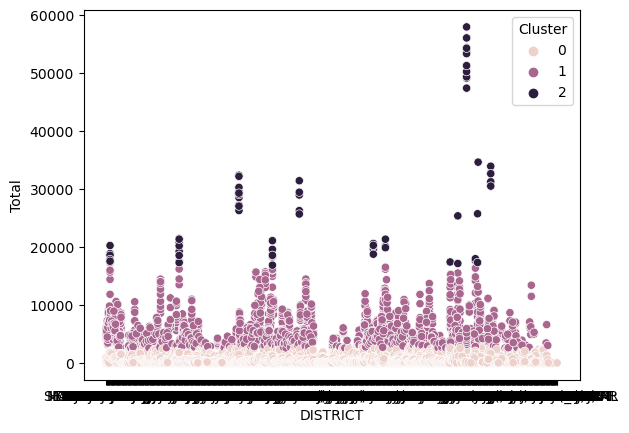

In [71]:
sns.scatterplot(x='DISTRICT', y='Total', hue='Cluster', data=dff)
plt.show()

Hence we can conclude that below is the categorization by clustering:
    <br>0 -> Peaceful Area
    <br>1 -> Moderate Area
    <br>2 -> Sensitive Area

### Second approach

In [123]:
snd = nd.copy()
label1 = LabelEncoder()
label2 = LabelEncoder()
snd['STATE/UT'] = label1.fit_transform(snd['STATE/UT'])
snd['DISTRICT'] = label2.fit_transform(snd['DISTRICT'])

In [124]:
snd.drop(columns=['YEAR'],inplace=True)

In [125]:
snd['TOTAL'] = snd[[col for col in snd.columns if col not in ['STATE/UT','DISTRICT']]].sum(axis=1)

In [126]:
# we will use snd[['STATE/UT','DISTRICT','TOTAL']] for model clustering

In [127]:
snd[['STATE/UT','DISTRICT','TOTAL']]

,STATE/UT,DISTRICT,TOTAL
0,0,2,999.0
1,0,2,999.0
2,0,31,740.0
3,0,31,655.0
4,0,31,702.0
...,...,...,...
9251,35,787,3755.0
9252,35,787,4047.0
9253,35,787,5245.0
9254,35,787,5546.0


In [128]:
kmeans = KMeans(n_clusters=3, random_state=42)
kmeans.fit(snd[['STATE/UT','DISTRICT','TOTAL']])

C:\ProgramData\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


KMeans(n_clusters=3, random_state=42)

In [129]:
kmeans.predict(snd[['STATE/UT','DISTRICT','TOTAL']])

array([0, 0, 0, ..., 1, 1, 1])

In [130]:
snd['Cluster'] = kmeans.labels_

In [131]:
df.Cluster.value_counts()

Cluster
0    39457
1     3483
2       75
Name: count, dtype: int64

In [157]:
snd.Cluster.value_counts()

Cluster
Peaceful    6362
Moderate    2310
2            140
Name: count, dtype: int64

In [133]:
# Clustering after aggregating based on district looks to be good.

In [134]:
snd['STATE/UT'] = label1.inverse_transform(snd['STATE/UT'])
snd['DISTRICT'] = label2.inverse_transform(snd['DISTRICT'])

In [135]:
snd[snd.Cluster==2]

,MURDER,ATTEMPT TO MURDER,CULPABLE HOMICIDE NOT AMOUNTING TO MURDER,RAPE,CUSTODIAL RAPE,OTHER RAPE,KIDNAPPING & ABDUCTION,KIDNAPPING AND ABDUCTION OF WOMEN AND GIRLS,KIDNAPPING AND ABDUCTION OF OTHERS,DACOITY,...,Other Crimes,Dowry Deaths,Assault on women with intent to outrage her modesty,Insult to modesty of Women,Cruelty by Husband or his Relatives,Importation of Girls,STATE/UT,DISTRICT,TOTAL,Cluster
87,150.0,88.0,10.0,44.0,0.0,44.0,151.0,58.0,93.0,26.0,...,0.0,34.0,119.0,96.0,701.0,3.0,ANDHRA PRADESH,CYBERABAD,15808.0,2
88,193.0,92.0,11.0,60.0,0.0,60.0,166.0,90.0,76.0,13.0,...,1.0,50.0,132.0,93.0,837.0,0.0,ANDHRA PRADESH,CYBERABAD,18272.0,2
89,186.0,84.0,8.0,45.0,0.0,45.0,147.0,100.0,47.0,21.0,...,0.0,41.0,118.0,55.0,881.0,0.0,ANDHRA PRADESH,CYBERABAD,18819.0,2
90,197.0,66.0,3.0,80.0,0.0,80.0,141.0,101.0,40.0,7.0,...,0.0,59.0,130.0,833.0,884.0,0.0,ANDHRA PRADESH,CYBERABAD,19840.0,2
91,186.0,84.0,15.0,82.0,0.0,82.0,168.0,113.0,55.0,11.0,...,0.0,46.0,173.0,155.0,991.0,0.0,ANDHRA PRADESH,CYBERABAD,20259.0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9158,185.0,620.0,36.0,526.0,0.0,526.0,511.0,441.0,70.0,18.0,...,0.0,45.0,609.0,6.0,2927.0,0.0,WEST BENGAL,MURSHIDABAD,19697.0,2
9159,145.0,637.0,28.0,433.0,0.0,433.0,566.0,492.0,74.0,21.0,...,19.0,49.0,621.0,5.0,2956.0,0.0,WEST BENGAL,MURSHIDABAD,21259.0,2
9160,174.0,395.0,30.0,257.0,0.0,257.0,579.0,464.0,115.0,9.0,...,4.0,39.0,609.0,6.0,2831.0,0.0,WEST BENGAL,MURSHIDABAD,19122.0,2
9171,136.0,375.0,26.0,185.0,0.0,185.0,500.0,453.0,47.0,25.0,...,0.0,65.0,128.0,2.0,1923.0,0.0,WEST BENGAL,NADIA,17090.0,2


In [138]:
snd.to_excel('clustered_second_approach.xlsx')

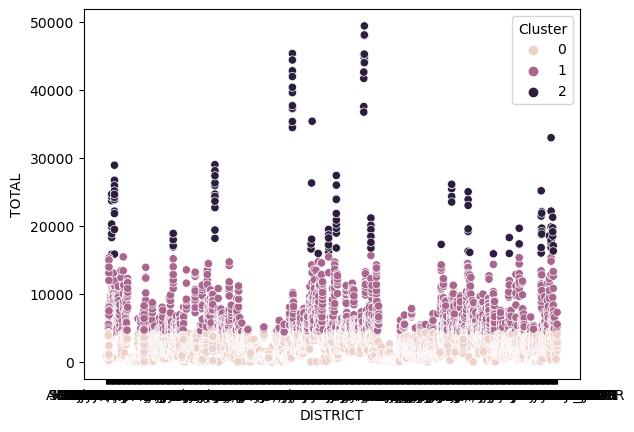

In [140]:
sns.scatterplot(x='DISTRICT', y='TOTAL', hue='Cluster', data=snd)
plt.show()

We can see that the associations made are as per our expectations

### Dataframe according to area and cluster

In [158]:
snd['Cluster'] = snd['Cluster'].replace({0:'Peaceful',1:'Moderate',2:'Sensitive'})

In [159]:
snd[['STATE/UT','DISTRICT','Cluster']]

,STATE/UT,DISTRICT,Cluster
0,A & N ISLANDS,A and N ISLANDS,Peaceful
1,A & N ISLANDS,A and N ISLANDS,Peaceful
2,A & N ISLANDS,ANDAMAN,Peaceful
3,A & N ISLANDS,ANDAMAN,Peaceful
4,A & N ISLANDS,ANDAMAN,Peaceful
...,...,...,...
9251,WEST BENGAL,UTTAR DINAJPUR,Peaceful
9252,WEST BENGAL,UTTAR DINAJPUR,Peaceful
9253,WEST BENGAL,UTTAR DINAJPUR,Moderate
9254,WEST BENGAL,UTTAR DINAJPUR,Moderate


### Cluster analysis

In [161]:
snd[snd['Cluster']=='Sensitive'].to_excel('sensitive.xlsx')

In [162]:
snd[snd['Cluster']=='Sensitive']['DISTRICT'].unique()

array(['CYBERABAD', 'HYDERABAD CITY', 'PATNA', 'AHMEDABAD COMMR.',
       'BANGALORE COMMR.', 'ERNAKULAM', 'ERNAKULAM COMMR.',
       'ERNAKULAM RURAL', 'MALAPPURAM', 'BHOPAL', 'INDORE', 'MUMBAI',
       'MUMBAI COMMR.', 'PUNE COMMR.', 'ALWAR', 'JAIPUR', 'CHENNAI',
       'COIMBATORE RURAL', 'AGRA', 'GHAZIABAD', 'LUCKNOW',
       '24 PARGANAS NORTH', '24 PARGANAS SOUTH', 'JALPAIGURI', 'KOLKATA',
       'MURSHIDABAD', 'NADIA'], dtype=object)

1. **Help Victims of Crime**:
   - Provide support and resources for victims. Prior victimization is a strong predictor of future victimization¹.
   
2. **Increase Community Awareness**:
   - Encourage residents to be vigilant and aware of their surroundings.
   - Promote neighborhood watch programs and community engagement.
   
3. **Environmental Design**:
   - Improve lighting in public spaces to reduce hiding spots for criminals.
   - Maintain well-kept streets, parks, and buildings to discourage criminal activity.
   
4. **Target Hotspots**:
   - Identify high-crime areas (like the sensitive clusters in your data) and allocate resources accordingly.
   - Focus on crime prevention efforts in these hotspots.
   
5. **Community Policing**:
   - Build positive relationships between police officers and community members.
   - Involve residents in problem-solving and decision-making.
   
6. **Education and Outreach**:
   - Educate residents about crime prevention techniques.
   - Conduct workshops on personal safety, home security, and reporting suspicious activity.
   
7. **Collaborate with Other Agencies**:
   - Work with social services, mental health professionals, and schools to address underlying issues.
   - Address substance abuse, mental health, and poverty.
   
8. **Data-Driven Approaches**:
   - Analyze crime data to identify patterns and trends.
   - Use predictive analytics to allocate resources effectively.
   
9. **Target Repeat Offenders**:
   - Focus on individuals with a history of criminal behavior.
   - Implement intervention programs to reduce recidivism.
   

In [174]:
sens = snd[snd['Cluster']=='Sensitive'][[col for col in snd.columns if col not in ['STATE/UT','DISTRICT','Cluster','TOTAL']]]

In [180]:
sens = snd[snd['Cluster']=='Sensitive']

C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_15780\983112129.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(1,1)


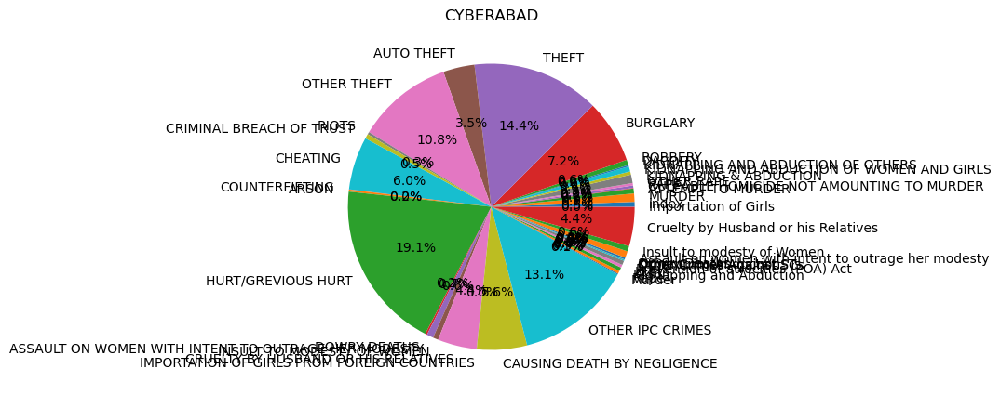

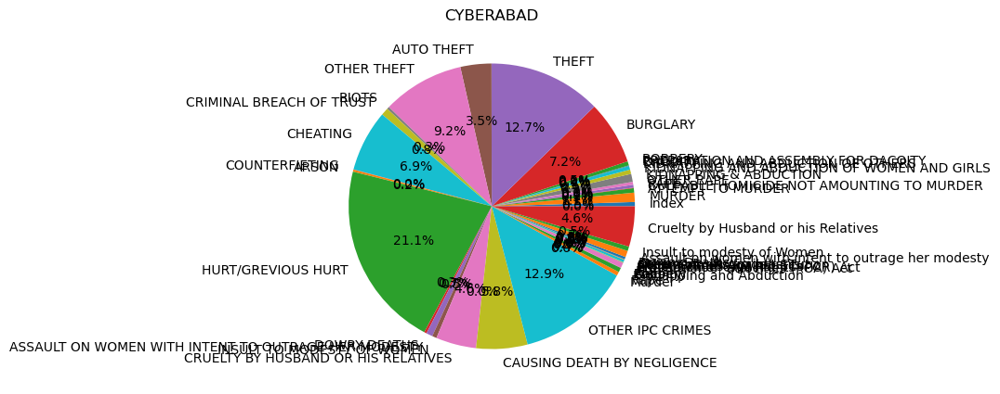

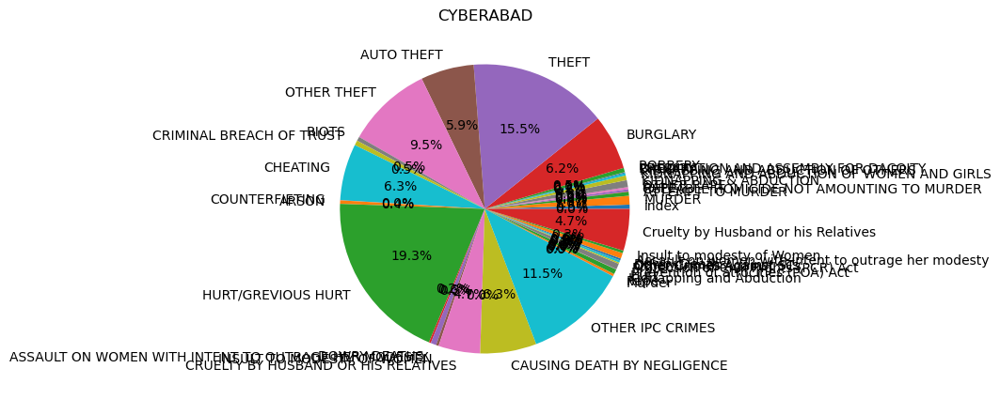

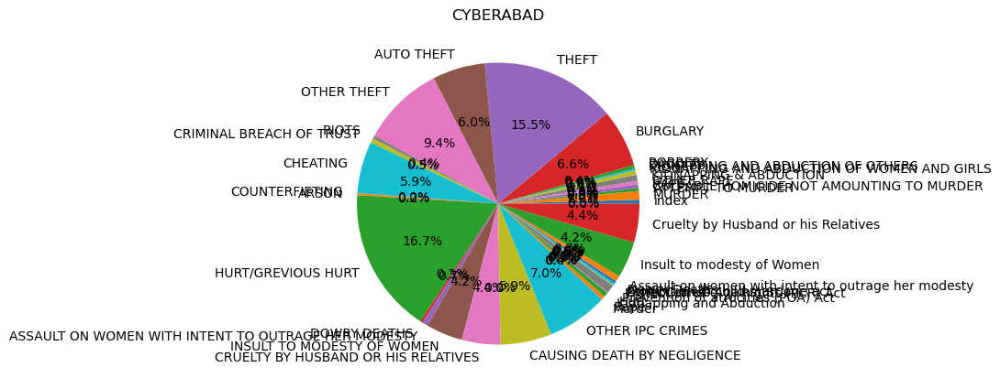

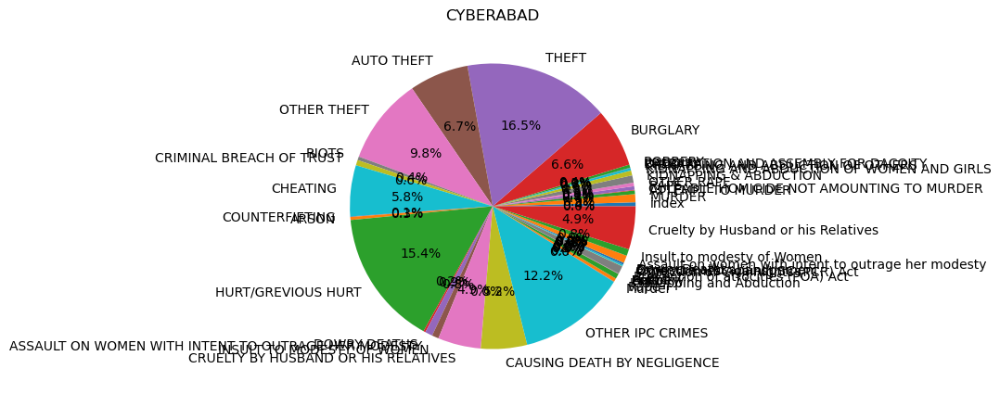

...

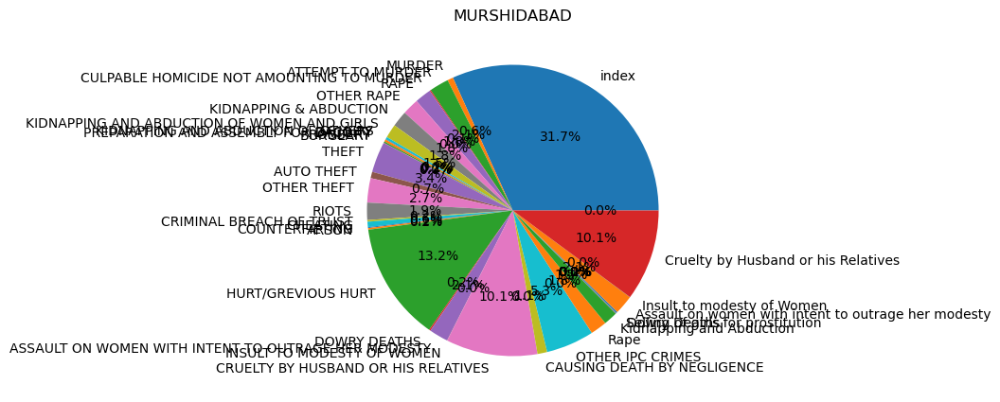

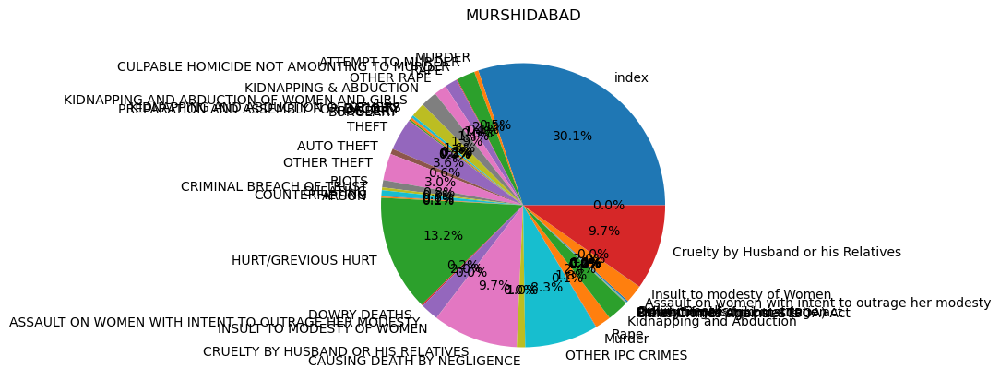

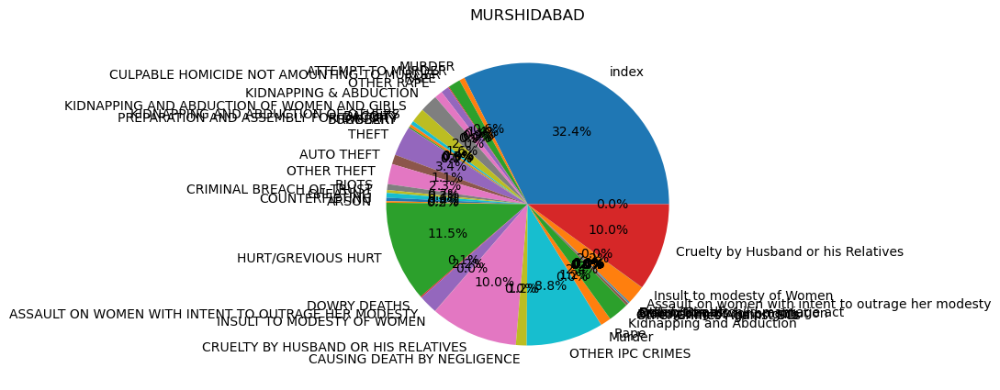

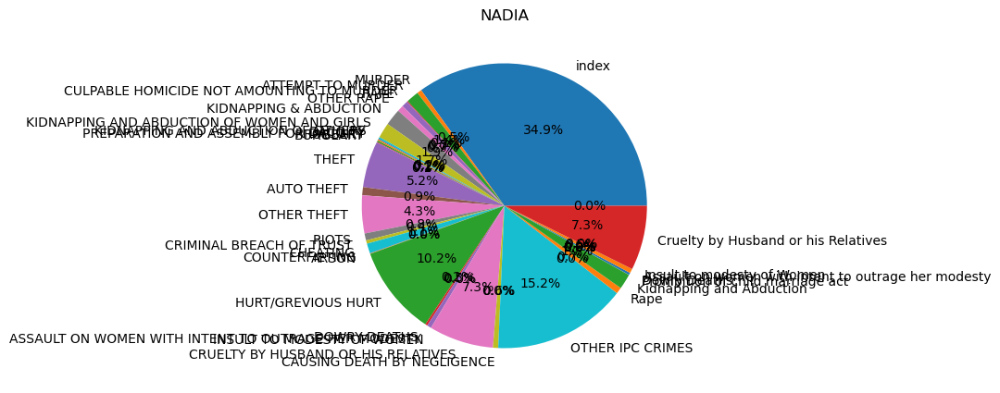

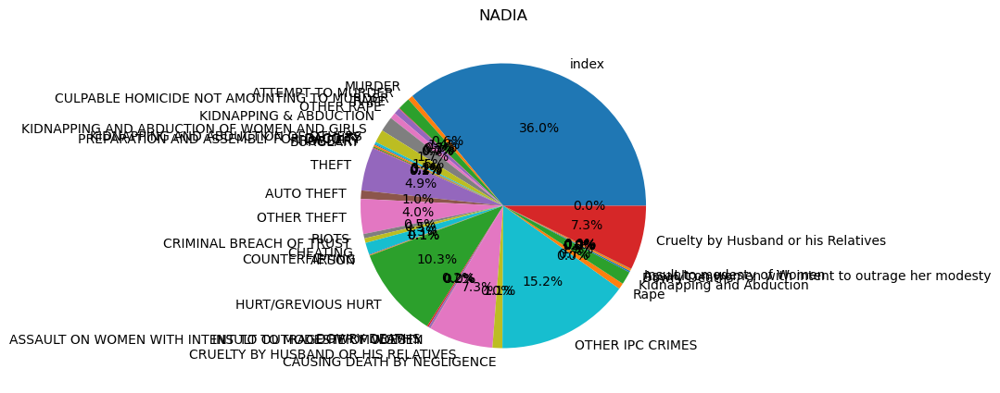

In [181]:
sens_drop = sens.reset_index(inplace=False).drop(columns=['STATE/UT','DISTRICT','Cluster','TOTAL'])
for ind in sens.reset_index().index:
   fig, ax = plt.subplots(1,1)
   fig.set_size_inches(5,5)
   sens_drop.iloc[ind].plot(kind='pie', ax=ax, autopct='%1.1f%%')
   ax.set_ylabel('')
   ax.set_xlabel('')
   ax.set_title(sens.reset_index().loc[ind,'DISTRICT'])

We can see that most  of the cases are due to hurt / Grevious hurt and Theft. Need to take measures to reduce those incidents. Keep CC cameras all in districts where there are heavy instances. That would make public think before doing those activities.

In [184]:
snd[snd['Cluster']=='Peaceful']['DISTRICT'].unique()

array(['A and N ISLANDS', 'ANDAMAN', 'CAR', 'NICOBAR', 'NORTH', 'SOUTH',
       'CUDDAPAH', 'GUNTAKAL RLY.', 'RAJAHMUNDRY', 'RANGA REDDY',
       'SECUNDERABAD RLY.', 'SRIKAKULAM', 'TIRUPATHI URBAN',
       'VIJAYAWADA RLY.', 'VISAKHA RURAL', 'VISAKHAPATNAM',
       'VIZIANAGARAM', 'WARANGAL', 'WARANGAL URBAN', 'ANJAW', 'CHANGLANG',
       'DIBANG VALLEY', 'K/KUMEY', 'KAMENG EAST', 'KAMENG WEST', 'LOHIT',
       'PAPUM PARE', 'RURAL', 'SIANG EAST', 'SIANG UPPER', 'SIANG WEST',
       'SUBANSIRI LOWER', 'SUBANSIRI UPPER', 'TAWANG', 'TIRAP',
       'UPPER DIBANG VALLEY', 'BAKSA', 'BARPETA', 'BASKA', 'BIEO',
       'BONGAIGAON', 'C.I.D.', 'CHIRANG', 'DARRANG', 'DHEMAJI', 'DHUBRI',
       'DIBRUGARH', 'G.R.P.', 'GOALPARA', 'GOLAGHAT', 'HAILAKANDI',
       'HAMREN', 'JORHAT', 'KAMRUP', 'KARBI ANGLONG', 'KARIMGANJ',
       'KOKRAJHAR', 'LAKHIMPUR', 'MORIGAON', 'N.C. HILLS', 'N.C.HILLS',
       'NAGAON', 'NALBARI', 'R.P.O.', 'SIBSAGAR', 'SONITPUR', 'TINSUKIA',
       'UDALGURI', 'ARARIA', 'AR

Above mentioned are the safest districts overall while the one above that are unsafe

## 4.4   Capstone project overall story in your own words. Min 1000 words.

Crime analysis is a multidisciplinary field that combines data science, law enforcement, and spatial analysis to understand criminal patterns, enhance public safety, and inform decision-making. It's like solving a complex puzzle where each piece represents a crime incident, and our goal is to reveal hidden connections and trends.

In our project, we embarked on an exciting journey to explore crime data, uncover insights, and contribute to safer communities. Here's our story:

1. **Data Collection and Preprocessing**
   We started by gathering crime data from various provided to us and by gathering information like population census, area analysis of different states. The raw data was messy, with missing values, inconsistent formats, and outliers. Our first task was meticulous data cleaning: handling missing entries, standardizing date formats, and removing anomalies. It took enormous effort to get all the data into single format where we can join multiple datasets representing multiple areas of crime so that it would be easy for us to analyse and find insights. It took a lot of replacing values, standardising state and district names, dropping and merging duplicate values, etc., Finally we had our data on single format platform.
 <br><br>

2. **Exploratory Data Analysis (EDA)**
   With clean data in hand, we did a lot of EDA work to anlayse the crime reports. There are many reports from different zoners of crime like crimes on sc, st, crimes on women, theft, ipc crimes and a lot other. we have to anlayse which kind of crimes are dominating. Also we have analysed second highest, third highest and so on to get great insights. We have created line graphs that shows how crime is being impacted with increase or decrease in literacy rate, how crime is being impacted with increase or decrease in area. Also we have created pie charts to perfectly show which types of crimes are most dominating and in which area. we have created a perfect analysis report for every state and which crimes are predominant in which state. We have analysed sensitive states and which crimes made them sensitive.
<br><br>
3. **Temporal Patterns**
       Time was our compass. We analyzed crime trends over years. We have observed that with increase in area of the state, there is a spike in crime rates. which means the bigger the state, the more the crime in general sense but that doesn't stand true in all cases. There are some drops too. which means there are states which have less are but high crime rates like Delhi. Being capital, it stood high in crimes as well. In most of the states, there is an year on year increase in crime rates while for a few, there is a downward trend. There might be reasons like strict police officers taking charge in those areas or people actually tending to do less crime due to high availability of opportunities of employment etc., There might be many reasons for the same. There might be other parameters that trigger crimes in sensitive areas like <br>
       - mindset of people which is a crucial factor which can have a greater impact on crime. In some areas, people tend to show violent natures which might make a great impact, but it doesn't mean we can't change their nature. With strict rules and regulations in place, like people should develop some sensitivity in them or they should atleast be a but afraid of law enforcement which will make them abide to rules though they are not inherent to abide by nature. So strict law enforcement in sensitive areas may reduce crime in those areas.<br>
       - unemployment can make people do things like theft, robbery, etc., as we can see that majority of the incidents are of theft which indicates that there is significant thing which we might be missing like elephant in the room which we can't see. I presume that it's mainly unemployment in those states making people choose that way to live rather than being actually doing that intentionally. So if government can provide alternatives if not able to provide direct employment, it can reduce those instances to a great extent in my opinion
       - 
<br>
<br>
4. **Spatial Insights**
   Crimes doesn't follow pattern in general. There are instances of crime in very peaceful areas too. Though we can analyse past crime trends and sensitivity of areas based on the previous data, we can't judge the districts completely on previous history basis. For example there are places where crime rate is declining with years passing by. If we judge them by previous year where there is high crime, we would be completely wrong. Only thing that we can do is to develop a prospective that which state might have high crime.
<br>
5. **Clustering**
   Beyond descriptive analysis, we ventured into categorizing areas into clusters namely sensitive, moderate and peaceful. Peaceful areas are those which have very less crime rates, moderate have medium crime rates while sensitive have very high crime rates and are not in safe radar to live in. This classification can help poeple be careful when they are travelling or moving to a different state and district. They will take all necessary precautions to avoid being robbed or hurt due. We can observe that there are a lot of states and districts in India which are a lot safe. We have only few districts which are prone to have more crime rate. So we can suggest police force to increase protection in those areas and lesssen protection in safe areas. Thus we can effectively utilize police force by optimally and miniministically assigning them to only required areas there by reducing  crime rate drastically keeping people and their property safe all the times. With better and efficient allocation, we can get optimized and better results.

<br>
<br>
<br>
**Conclusion**
Our crime analysis project wasn't just about numbers—it was about people. Each data point represented a victim, a witness, or a perpetrator. As we pieced together the puzzle, we hoped for safer streets, fewer victims, and a city where everyone could walk without fear. With combined efforts from government and people we can one day surely achieve such cities with zero crime.

And so, our story continues—a blend of data, empathy, and determination. Crime analysis isn't just about algorithms; it's about making our world a little safer, one insight at a time.
 
Jai Hindh


Above is the detailed report in more than 1000 words